<center><h1>Pytorch GradCAM Evaluation</h1>
<h2>Matthias Bartolo</h2>

</center>


#### Package Imports

In [1]:
# !pip install grad-cam

In [2]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
import cv2
import numpy as np
import torch
import torchvision
import random
import os
import requests
from PIL import Image
from pytorch_grad_cam import AblationCAM, EigenCAM, GradCAM, GradCAMPlusPlus
from pytorch_grad_cam.ablation_layer import AblationLayerFasterRCNN
from pytorch_grad_cam.utils.model_targets import FasterRCNNBoxScoreTarget
from pytorch_grad_cam.utils.reshape_transforms import fasterrcnn_reshape_transform
from pytorch_grad_cam.utils.image import show_cam_on_image, scale_accross_batch_and_channels, scale_cam_image
from torchvision.models.detection.retinanet import RetinaNetClassificationHead
from torchvision.models.detection.fcos import FCOSClassificationHead
from torchvision.models.detection.ssd import SSDClassificationHead
from torchvision.models.detection.ssdlite import SSDLiteClassificationHead
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from functools import partial
import matplotlib.pyplot as plt
import copy

NUM_CHANNELS = 3
NUM_CLASSES = 2
COLORS = np.array([[0, 0, 0], [80, 150, 80]])  # Background is black, Litter is red
class_names = ['__background__', 'Litter']
image_results = {}
iou_threshold = 0.7
iou_threshold2 = 0.5

#### Prediction and Visualization Functions


In [3]:
def predict(input_tensor, model, device, detection_threshold, iou_threshold=0.5):
    """
    Predict bounding boxes with confidence threshold and apply Non-Maximum Suppression (NMS).

    Args:
        input_tensor: Input tensor [batch_size, C, H, W]
        model: The detection model
        device: Device to run on (cpu/cuda)
        detection_threshold: Minimum score to keep a detection
        iou_threshold: IOU threshold for NMS

    Returns:
        boxes, classes, labels, indices, scores
    """

    model.eval()
    with torch.no_grad():
        outputs = model(input_tensor.to(device))

    pred_labels = outputs[0]['labels'].cpu()
    pred_scores = outputs[0]['scores'].cpu()
    pred_boxes = outputs[0]['boxes'].cpu()

    # Apply detection threshold
    mask = pred_scores >= detection_threshold
    pred_boxes = pred_boxes[mask]
    pred_labels = pred_labels[mask]
    pred_scores = pred_scores[mask]

    if pred_boxes.nelement() == 0:
        # No predictions above threshold
        return [], [], [], [], []

    # Apply NMS
    nms_indices = torchvision.ops.nms(pred_boxes, pred_scores, iou_threshold)

    # Select only NMS indices
    pred_boxes = pred_boxes[nms_indices]
    pred_labels = pred_labels[nms_indices]
    pred_scores = pred_scores[nms_indices]

    pred_classes = [class_names[i] for i in pred_labels.numpy()]

    # Collect results
    boxes = pred_boxes.numpy().astype(np.int32)
    classes = pred_classes
    labels = pred_labels.numpy()
    indices = nms_indices.numpy()
    scores = pred_scores.numpy()

    return boxes, classes, labels, indices, scores

def draw_boxes(boxes, labels, class_names, scores, image, font_scale=3, box_thickness=15, resize_size=(2048, 1080)):
    """
    Draws bounding boxes and labels on an image using class_names and color per class index.

    Args:
        boxes (list): Bounding box coordinates [x_min, y_min, x_max, y_max].
        labels (list): Class indices.
        class_names (list): List of class names indexed by class ID.
        image (np.ndarray): Image to draw on.
        font_scale (int, optional): Font size for text. Default is 3.
        box_thickness (int, optional): Thickness of bounding boxes. Default is 15.
        resize_size (tuple, optional): Final image size. Default is (2048, 1080).

    Returns:
        np.ndarray: Image with boxes and labels drawn.
    """
    output_image = image.copy()
    for i, box in enumerate(boxes):
        x_min, y_min, x_max, y_max = map(int, box)

        # Create the label with score and class name
        class_name = f"{class_names[i]} {scores[i] * 100:.2f}%"
        
        # Assign color to the bounding box based on class index
        color = COLORS[labels[i] % len(COLORS)]
        color = tuple(color.tolist())

        # Draw the bounding box
        cv2.rectangle(output_image, (x_min, y_min), (x_max, y_max), color, box_thickness)

        # Calculate the text size for the label
        (text_width, text_height), baseline = cv2.getTextSize(class_name, cv2.FONT_HERSHEY_SIMPLEX, font_scale, 2)
        padding = 15
        text_width += 2 * padding
        text_height += 2 * padding

        # Define the position for the label box
        top_left = (x_min, y_min - text_height - 10)
        bottom_right = (x_min + text_width, y_min - 5)

        # Draw the background for the text (to make it stand out)
        cv2.rectangle(output_image, top_left, bottom_right, color, -1)

        # Place the label text on the image
        text_position = (x_min + padding, y_min - padding - 10)
        cv2.putText(output_image, class_name, text_position, cv2.FONT_HERSHEY_SIMPLEX,
                    font_scale, (255, 255, 255), 6, lineType=cv2.LINE_AA)

    # Resize the image for final output
    output_image = cv2.resize(output_image, resize_size)
    return output_image

#### Loading Images

In [4]:
# directory with image paths
image_dir = '../Assets/test_images/SODA/'
# Load all the images in the directory
image_paths = [os.path.join(image_dir, f) for f in os.listdir(image_dir) if f.endswith('.jpg')]

# Read and prepare the image
image_path = random.choice(image_paths)
image_path = '../Assets/test_images/SODA/IMG_1231_00_jpeg.rf.4fc9936121ffc86f86a84457cdd8213c.jpg'
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Resize the image to a fixed size (optional)
# image = cv2.resize(image, (800, 800))

# Convert to PIL Image
image_pil = Image.fromarray(image)

# Save a float32 copy for CAM (if needed)
image_float_np = np.float32(image) / 255
original_image = image.copy()

# Define the transforms
transform = torchvision.transforms.Compose([
    # torchvision.transforms.Resize((800, 800)),
    torchvision.transforms.ToTensor(),
])

# Apply the transform to the PIL image
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
input_tensor = transform(image_pil).to(device)
input_tensor = input_tensor.to(device)
# Add a batch dimension:
input_tensor = input_tensor.unsqueeze(0)
# input_tensor.requires_grad_()  # Enable gradient computation for the input

#### RetinaNet Model

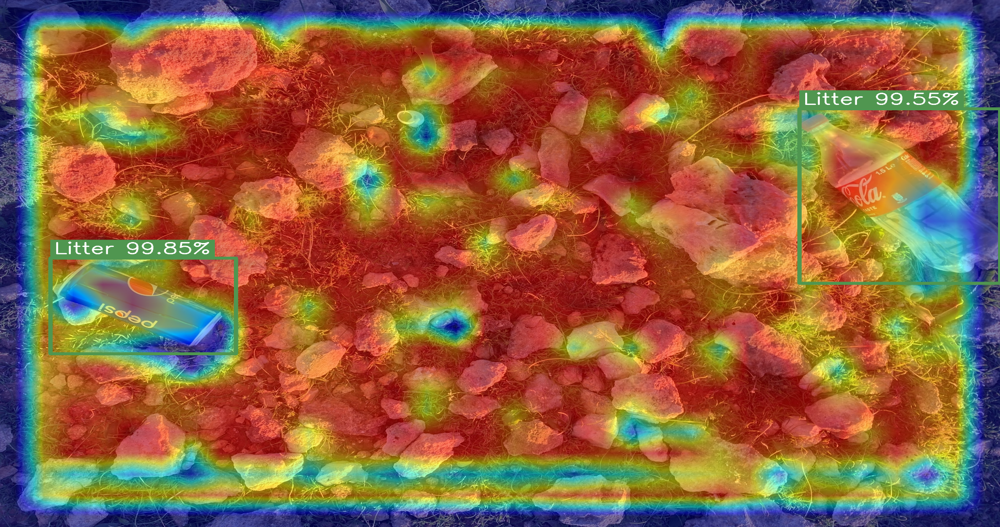

In [5]:
# Load the model weights
# Load the RetinaNet model with pretrained weights
weights = torchvision.models.detection.RetinaNet_ResNet50_FPN_Weights.DEFAULT
pre_trained_model = torchvision.models.detection.retinanet_resnet50_fpn(weights=weights)

model = pre_trained_model.to(device)

# Get the number of input features for the classification head
in_features = model.head.classification_head.cls_logits.in_channels
num_anchors = model.head.classification_head.num_anchors

# Modify classification head to match the number of classes for your task
# RetinaNetClassificationHead is redefined to include the correct number of classes
model.head.classification_head = RetinaNetClassificationHead(
    in_channels=in_features,
    num_classes=NUM_CLASSES,
    num_anchors=num_anchors,
    norm_layer=partial(torch.nn.GroupNorm, 32)
)

# Move the model to the correct device (e.g., CUDA or CPU)
model = model.to(device)

model.load_state_dict(torch.load('../runs/SODA 01m/RetinaNet/RetinaNet_rgb_binary_student1/weights/best.pth'))
model.eval().to(device)

###############################
# Run the model and display the detections
boxes, classes, labels, indices, scores = predict(input_tensor, model, device, iou_threshold)
image = draw_boxes(boxes, labels, classes, scores, original_image.copy())

class RetinaNetBoxScoreTarget:
    """
    For each ground truth box and label, find the best-matching prediction from RetinaNet outputs.
    A prediction only contributes to the score if:
        - Its IOU with the ground truth box is above the threshold.
        - It has the correct class label.

    The total score is the sum of (IOU + confidence score) for matched predictions.
    """

    def __init__(self, labels, bounding_boxes, iou_threshold=0.5):
        self.labels = labels
        self.bounding_boxes = bounding_boxes
        self.iou_threshold = iou_threshold

    def __call__(self, model_outputs):
        score_sum = torch.tensor(0.0)

        if torch.cuda.is_available():
            score_sum = score_sum.cuda()
        elif torch.backends.mps.is_available():
            score_sum = score_sum.to("mps")

        boxes_pred = model_outputs.get("boxes", [])
        scores_pred = model_outputs.get("scores", [])
        labels_pred = model_outputs.get("labels", [])

        if len(boxes_pred) == 0:
            return score_sum

        for gt_box, gt_label in zip(self.bounding_boxes, self.labels):
            gt_box_tensor = torch.tensor([gt_box], dtype=torch.float32)
            if torch.cuda.is_available():
                gt_box_tensor = gt_box_tensor.cuda()
            elif torch.backends.mps.is_available():
                gt_box_tensor = gt_box_tensor.to("mps")

            ious = torchvision.ops.box_iou(gt_box_tensor, boxes_pred)
            max_idx = ious.argmax()
            max_iou = ious[0, max_idx]

            if max_iou > self.iou_threshold and labels_pred[max_idx] == gt_label:
                match_score = max_iou + scores_pred[max_idx]
                score_sum += match_score

        return score_sum
    
def retinanet_reshape_transform(x):
    return x

target_layers = [model.backbone.body.layer4[2]]

targets = [RetinaNetBoxScoreTarget(labels, boxes, iou_threshold=iou_threshold2)]
# Create the EigenCAM object
cam = EigenCAM(model,
               target_layers, 
               reshape_transform=retinanet_reshape_transform)

grayscale_cam = cam(input_tensor, targets=targets)
# Take the first image in the batch:
grayscale_cam = grayscale_cam[0, :]
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)
# And lets draw the boxes again:
image_with_bounding_boxes = draw_boxes(boxes, labels, classes, scores, cam_image)
Image.fromarray(image_with_bounding_boxes)
# del model

# Create the GradCAM object
cam = GradCAM(model=model,
              target_layers=target_layers,
              reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes2 = draw_boxes(boxes, labels, classes, scores, cam_image)

# Create the GradCAM++ object
cam = GradCAMPlusPlus(model=model,
                      target_layers=target_layers,
                      reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes3 = draw_boxes(boxes, labels, classes, scores, cam_image)

del model

# Add to the image results dictionary
image_results["RetinaNet"] = {"predicted_boxes": boxes, "predicted_classes": classes, "predicted_labels": labels, "predicted_scores": scores, "image": image.copy(), "eigen_cam": cam_image.copy(), "image_with_bounding_boxes": image_with_bounding_boxes.copy(), "grad_cam":image_with_bounding_boxes2, "grad_cam_plus_plus": image_with_bounding_boxes3}
# Show the image:
Image.fromarray(image_with_bounding_boxes)

In [6]:
# Image.fromarray(image_with_bounding_boxes2)

In [7]:
# Image.fromarray(image_with_bounding_boxes3)

In [8]:
# Image.fromarray(image)

#### FCOS Model

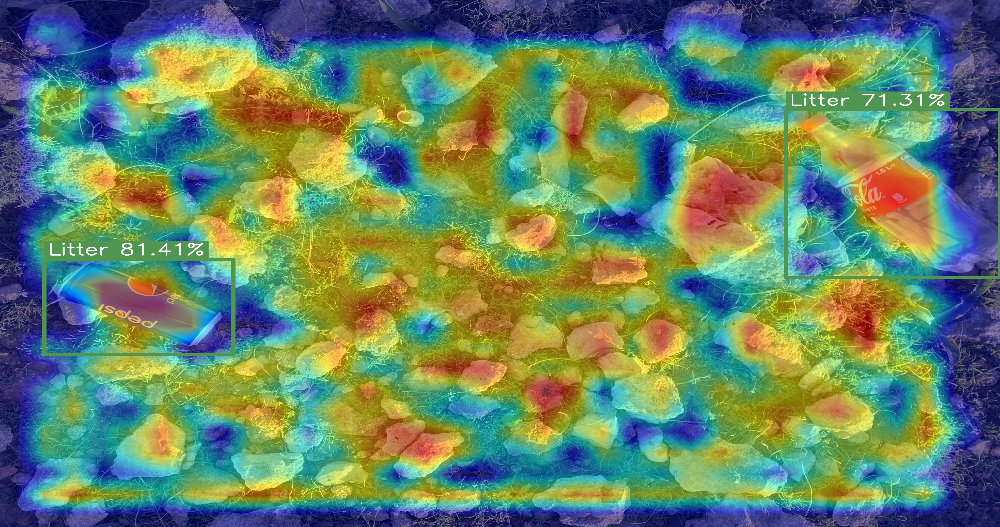

In [9]:
# Load the model weights
# Load the FCOS model with pretrained weights
weights = torchvision.models.detection.FCOS_ResNet50_FPN_Weights.DEFAULT
pre_trained_model = torchvision.models.detection.fcos_resnet50_fpn(weights=weights)

model = pre_trained_model.to(device)

# Modify the first convolutional layer for 4-channel input
model.backbone.body.conv1 = torch.nn.Conv2d(NUM_CHANNELS, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

# Initialize the first convolutional layer's weights
torch.nn.init.kaiming_normal_(model.backbone.body.conv1.weight, mode='fan_out', nonlinearity='relu')

# Get the correct number of input features for the classifier
# Get the number of input channels from the classification head
in_features = model.head.classification_head.cls_logits.in_channels
num_anchors = model.head.classification_head.num_anchors

# Modify classification head to match the number of classes for your task
# FCOSClassificationHead is redefined to include the correct number of classes
model.head.classification_head = FCOSClassificationHead(
    in_channels=in_features,
    num_classes=NUM_CLASSES,
    num_anchors=num_anchors,
    norm_layer=partial(torch.nn.GroupNorm, 32)
)

# Move the model to the correct device (e.g., CUDA or CPU)
model = model.to(device)

model.load_state_dict(torch.load('../runs/SODA 01m/FCOS/FCOS_rgb_binary_student1/weights/best.pth'))
model.eval().to(device)

###############################
class FCOSBoxScoreTarget:
    """
    For each ground truth box and label, find the best-matching prediction from FCOS outputs.
    A prediction only contributes to the score if:
        - Its IOU with the ground truth box is above the threshold.
        - It has the correct class label.
        - It includes the center-ness score to decide on confident predictions.

    The total score is the sum of (IOU + confidence score + center-ness score) for matched predictions.
    """

    def __init__(self, labels, bounding_boxes, iou_threshold=0.5):
        self.labels = labels
        self.bounding_boxes = bounding_boxes
        self.iou_threshold = iou_threshold

    def __call__(self, model_outputs):
        score_sum = torch.tensor(0.0)

        if torch.cuda.is_available():
            score_sum = score_sum.cuda()
        elif torch.backends.mps.is_available():
            score_sum = score_sum.to("mps")

        # Get FCOS outputs
        boxes_pred = model_outputs.get("boxes", [])  # Predicted bounding boxes
        scores_pred = model_outputs.get("scores", [])  # Prediction confidence scores
        labels_pred = model_outputs.get("labels", [])  # Predicted labels
        centerness_pred = model_outputs.get("centerness", [])  # Predicted center-ness scores

        if len(boxes_pred) == 0:
            return score_sum

        for gt_box, gt_label in zip(self.bounding_boxes, self.labels):
            gt_box_tensor = torch.tensor([gt_box], dtype=torch.float32)
            if torch.cuda.is_available():
                gt_box_tensor = gt_box_tensor.cuda()
            elif torch.backends.mps.is_available():
                gt_box_tensor = gt_box_tensor.to("mps")

            # Calculate IOU between ground truth box and predicted boxes
            ious = torchvision.ops.box_iou(gt_box_tensor, boxes_pred)
            max_idx = ious.argmax()  # Index of the best matching prediction
            max_iou = ious[0, max_idx]

            # Check if the IOU exceeds the threshold and if the labels match
            if max_iou > self.iou_threshold and labels_pred[max_idx] == gt_label:
                # The center-ness score could be important in FCOS to ensure object center confidence
                center_score = centerness_pred[max_idx] if centerness_pred else 1.0  # Default to 1 if no center-ness
                match_score = max_iou + scores_pred[max_idx] + center_score
                score_sum += match_score

        return score_sum
    

def fcos_reshape_transform(x):
    return x

# Run the model and display the detections
boxes, classes, labels, indices, scores = predict(input_tensor, model, device, iou_threshold)

image = draw_boxes(boxes, labels, classes, scores, original_image.copy())

# Choose the feature map layer for CAM
target_layers = [model.backbone.body.layer4[2]]

targets = [FCOSBoxScoreTarget(labels, boxes, iou_threshold=iou_threshold2)]

cam = EigenCAM(model,
               target_layers, 
               reshape_transform=fcos_reshape_transform)

grayscale_cam = cam(input_tensor, targets=targets)
# Take the first image in the batch:
grayscale_cam = grayscale_cam[0, :]
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)
# And lets draw the boxes again:
image_with_bounding_boxes = draw_boxes(boxes, labels, classes, scores, cam_image)
Image.fromarray(image_with_bounding_boxes)
# del model

# Create the GradCAM object
cam = GradCAM(model=model,
              target_layers=target_layers,
              reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes2 = draw_boxes(boxes, labels, classes, scores, cam_image)

# Create the GradCAM++ object
cam = GradCAMPlusPlus(model=model,
                      target_layers=target_layers,
                      reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes3 = draw_boxes(boxes, labels, classes, scores, cam_image)

del model

# Add to the image results dictionary
image_results["FCOS"] = {"predicted_boxes": boxes, "predicted_classes": classes, "predicted_labels": labels, "predicted_scores": scores, "image": image.copy(), "eigen_cam": cam_image.copy(), "image_with_bounding_boxes": image_with_bounding_boxes.copy(), "grad_cam":image_with_bounding_boxes2, "grad_cam_plus_plus": image_with_bounding_boxes3}
# Show the image:
Image.fromarray(image_with_bounding_boxes)

In [10]:
# Image.fromarray(image_with_bounding_boxes2)

In [11]:
# Image.fromarray(image_with_bounding_boxes3)

In [12]:
# Image.fromarray(image)

#### Faster R-CNN Model

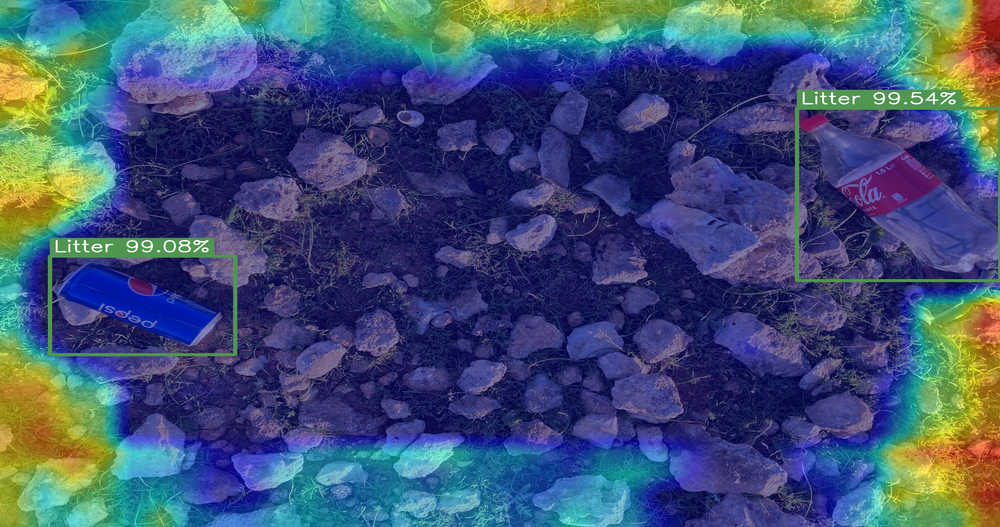

In [13]:
# Load the model weights
# Load the FasterRCNN model with pretrained weights
weights = torchvision.models.detection.FasterRCNN_ResNet50_FPN_Weights.DEFAULT
pre_trained_model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=weights)

model = pre_trained_model.to(device)

# Modify the first convolutional layer for 4-channel input
model.backbone.body.conv1 = torch.nn.Conv2d(NUM_CHANNELS, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False).to(device)

# Initialize the first convolutional layer's weights (was not working with the default initialization)
torch.nn.init.kaiming_normal_(model.backbone.body.conv1.weight, mode='fan_out', nonlinearity='relu')

# Get number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features

# Replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, NUM_CLASSES).to(device)
# norm_layer=partial(torch.nn.GroupNorm, 32),  # Normalization layer

# Move the model to the correct device (e.g., CUDA or CPU)
model = model.to(device)
# These don't seem to be necessary, but are included for completeness
model.to(device)
model.backbone.body.conv1.to(device)
model.rpn.to(device)
model.roi_heads.to(device)

model.load_state_dict(torch.load('../runs/SODA 01m/FasterRCNN/FasterRCNN_rgb_binary_student1/weights/best.pth'))
model.eval().to(device)

###############################
# Run the model and display the detections
boxes, classes, labels, indices, scores = predict(input_tensor, model, device, iou_threshold)
image = draw_boxes(boxes, labels, classes, scores, original_image.copy())

target_layers = [model.backbone.body.layer4[2]]
targets = [RetinaNetBoxScoreTarget(labels=labels, bounding_boxes=boxes, iou_threshold=iou_threshold2)]
cam = EigenCAM(model,
               target_layers, 
               reshape_transform=retinanet_reshape_transform)

grayscale_cam = cam(input_tensor, targets=targets)
# Take the first image in the batch:
grayscale_cam = grayscale_cam[0, :]
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)
# And lets draw the boxes again:
image_with_bounding_boxes = draw_boxes(boxes, labels, classes, scores, cam_image)
Image.fromarray(image_with_bounding_boxes)
# del model

# Create the GradCAM object
cam = GradCAM(model=model,
              target_layers=target_layers,
              reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes2 = draw_boxes(boxes, labels, classes, scores, cam_image)

# Create the GradCAM++ object
cam = GradCAMPlusPlus(model=model,
                      target_layers=target_layers,
                      reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes3 = draw_boxes(boxes, labels, classes, scores, cam_image)

del model

# Add to the image results dictionary
image_results["Faster R-CNN"] = {"predicted_boxes": boxes, "predicted_classes": classes, "predicted_labels": labels, "predicted_scores": scores, "image": image.copy(), "eigen_cam": cam_image.copy(), "image_with_bounding_boxes": image_with_bounding_boxes.copy(), "grad_cam":image_with_bounding_boxes2, "grad_cam_plus_plus": image_with_bounding_boxes3}
# Show the image:
Image.fromarray(image_with_bounding_boxes)

In [14]:
# Image.fromarray(image_with_bounding_boxes2)

In [15]:
# Image.fromarray(image_with_bounding_boxes3)

In [16]:
# Image.fromarray(image)

#### SSD Model

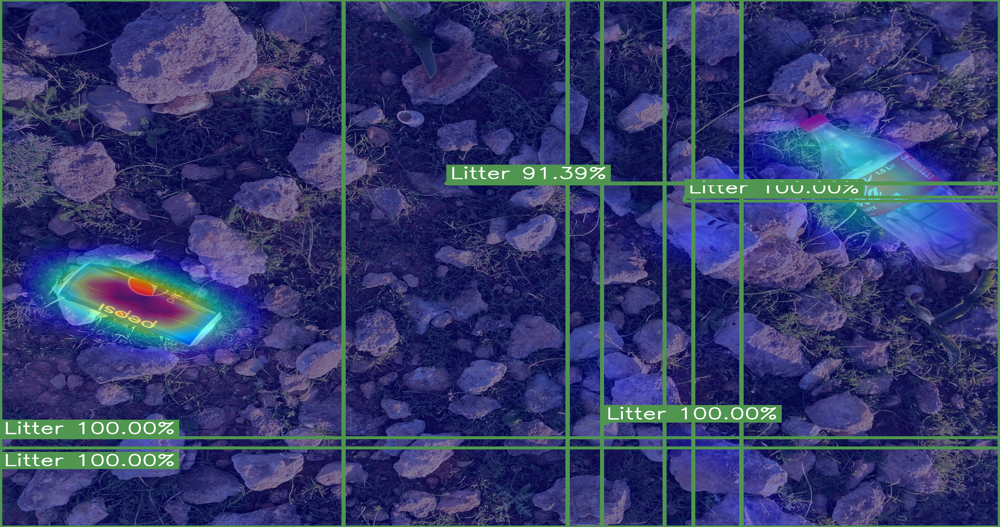

In [17]:
# Load the pretrained SSD model (standard SSD)
weights = torchvision.models.detection.SSD300_VGG16_Weights.DEFAULT
pre_trained_model = torchvision.models.detection.ssd300_vgg16(weights=weights)

model = pre_trained_model.to(device)

model.transform.to(device)

# Modify the classification head
# SSD uses a set of convolutional layers for the classification head, which needs to be adapted for your number of classes
# We need to retrieve the correct number of channels for each feature map in the SSD model
in_channels = [layer.in_channels for layer in model.head.classification_head.module_list]
num_anchors = model.anchor_generator.num_anchors_per_location()

# Redefine the classification head to match the number of classes
model.head.classification_head = SSDClassificationHead(
    in_channels=in_channels,  # List of input channels for each feature map
    num_anchors=num_anchors,  # List of anchors per location for each feature map
    num_classes=NUM_CLASSES,  # Number of classes (including background)
    # norm_layer=partial(torch.nn.GroupNorm, 32)
)

# Move the model to the correct device (e.g., CUDA or CPU)
model = model.to(device)

model.load_state_dict(torch.load(f'../runs/SODA 01m/SSD/SSD_rgb_binary_student1/weights/best.pth'))
model.eval().to(device)

###############################
# Run the model and display the detections
boxes, classes, labels, indices, scores = predict(input_tensor, model, device, iou_threshold)
image = draw_boxes(boxes, labels, classes, scores, original_image.copy())

class SSDBoxScoreTarget:
    """
    For each ground truth box and label, find the best-matching prediction from SSD outputs.
    A prediction only contributes to the score if:
        - Its IOU with the ground truth box is above the threshold.
        - It has the correct class label.
    """

    def __init__(self, labels, bounding_boxes, iou_threshold=0.5):
        self.labels = labels
        self.bounding_boxes = bounding_boxes
        self.iou_threshold = iou_threshold

    def __call__(self, model_outputs):
        score_sum = torch.tensor(0.0)

        if torch.cuda.is_available():
            score_sum = score_sum.cuda()
        elif torch.backends.mps.is_available():
            score_sum = score_sum.to("mps")

        boxes_pred = model_outputs.get("boxes", [])
        scores_pred = model_outputs.get("scores", [])
        labels_pred = model_outputs.get("labels", [])

        if len(boxes_pred) == 0:
            return score_sum

        for gt_box, gt_label in zip(self.bounding_boxes, self.labels):
            gt_box_tensor = torch.tensor([gt_box], dtype=torch.float32)
            if torch.cuda.is_available():
                gt_box_tensor = gt_box_tensor.cuda()
            elif torch.backends.mps.is_available():
                gt_box_tensor = gt_box_tensor.to("mps")

            ious = torchvision.ops.box_iou(gt_box_tensor, boxes_pred)
            max_idx = ious.argmax()
            max_iou = ious[0, max_idx]

            if max_iou > self.iou_threshold and labels_pred[max_idx] == gt_label:
                match_score = max_iou + scores_pred[max_idx]
                score_sum += match_score

        return score_sum

def ssd_reshape_transform(x):
    return x

# Choose the feature map layer for CAM
target_layers = [model.backbone.features[21]]  # Typically the last feature layer for SSD

targets = [SSDBoxScoreTarget(labels, boxes, iou_threshold=iou_threshold2)]

cam = EigenCAM(model,
               target_layers, 
               reshape_transform=ssd_reshape_transform)


grayscale_cam = cam(input_tensor, targets=targets)
# Take the first image in the batch:
grayscale_cam = grayscale_cam[0, :]

cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)
# And lets draw the boxes again:
image_with_bounding_boxes = draw_boxes(boxes, labels, classes, scores, cam_image)
Image.fromarray(image_with_bounding_boxes)

# Create the GradCAM object
cam = GradCAM(model=model,
              target_layers=target_layers,
              reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image2 = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes2 = draw_boxes(boxes, labels, classes, scores, cam_image2)

# Create the GradCAM++ object
cam = GradCAMPlusPlus(model=model,
                      target_layers=target_layers,
                      reshape_transform=retinanet_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image3 = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes3 = draw_boxes(boxes, labels, classes, scores, cam_image3)

del model

# Add to the image results dictionary
image_results["SSD"] = {"predicted_boxes": boxes, "predicted_classes": classes, "predicted_labels": labels, "predicted_scores": scores, "image": image.copy(), "eigen_cam": cam_image.copy(), "image_with_bounding_boxes": image_with_bounding_boxes.copy(), "grad_cam":image_with_bounding_boxes2, "grad_cam_plus_plus": image_with_bounding_boxes3, "grad_cam_heatmap": cam_image2.copy(), "grad_cam_plus_plus_heatmap": cam_image3.copy()}
# Show the image:
Image.fromarray(image_with_bounding_boxes)

In [18]:
# Image.fromarray(image_with_bounding_boxes2)

In [19]:
# Image.fromarray(image_with_bounding_boxes3)

In [20]:
# Image.fromarray(image)

#### SSDLite Model

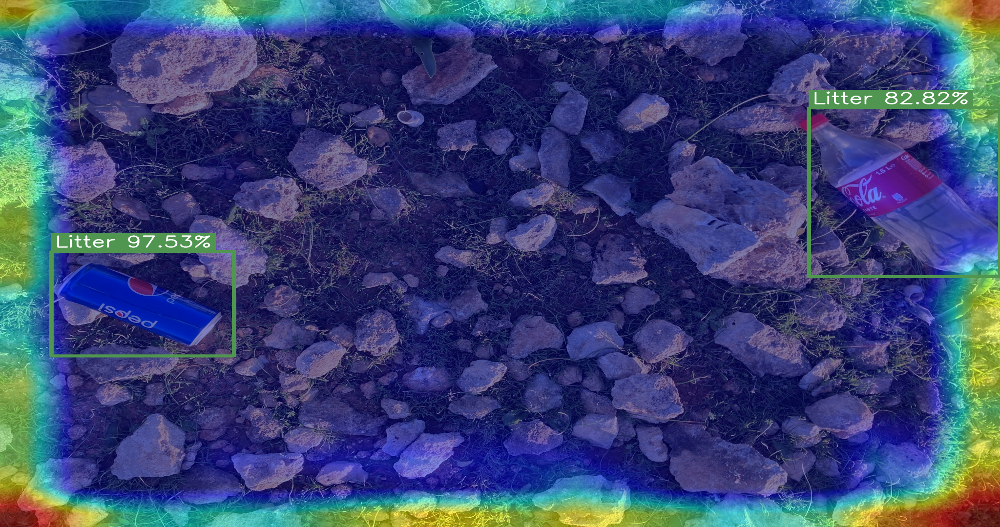

In [21]:
# Load the model weights
# Load the pretrained SSD model (SSDLite320 MobileNetV3)
weights = torchvision.models.detection.SSDLite320_MobileNet_V3_Large_Weights.DEFAULT
pre_trained_model = torchvision.models.detection.ssdlite320_mobilenet_v3_large(weights=weights)

model = pre_trained_model.to(device)

# Modify the first convolutional layer for 4-channel input
# In SSD, the input convolution layer is part of the VGG model's backbone
model.backbone.features[0][0][0] = torch.nn.Conv2d(NUM_CHANNELS, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)

# Initialize the first convolutional layer's weights
torch.nn.init.kaiming_normal_(model.backbone.features[0][0][0].weight, mode='fan_out', nonlinearity='relu')

# Modify the classification head
# SSD uses a set of convolutional layers for the classification head, which needs to be adapted for your number of classes
# https://stackoverflow.com/questions/71094251/fine-tuning-ssd-lite-in-torchvision
# from torchvision.models.detection import _utils as det_utils
# Forward a dummy image through the backbone to get output channels
tmp_img = torch.zeros((1, NUM_CHANNELS, 640, 640), dtype=torch.float32, device=device)
model.to(device)
with torch.no_grad():
    features = model.backbone(tmp_img)

# Extract feature map channels
if isinstance(features, torch.Tensor):
    in_channels = [features.shape[1]]  # Single feature map
else:
    in_channels = [f.shape[1] for f in features.values()]  # Multiple feature maps


num_anchors = model.anchor_generator.num_anchors_per_location()

# Redefine the classification head to match the number of classes
model.head.classification_head = SSDLiteClassificationHead(
    in_channels=in_channels,  # List of input channels for each feature map
    num_anchors=num_anchors,  # List of anchors per location for each feature map
    num_classes=NUM_CLASSES,  # Number of classes (including background)
    norm_layer=partial(torch.nn.GroupNorm, 32),  # Normalization layer
)

# Set the number of classes in the model
model.num_classes = NUM_CLASSES
model.head.num_classes = NUM_CLASSES

# Move the model to the correct device (e.g., CUDA or CPU)
model = model.to(device)

model.load_state_dict(torch.load('../runs/SODA 01m/SSDLite/SSDLite_rgb_binary_student1/weights/best.pth'))
model.eval().to(device)

###############################
# Run the model and display the detections
boxes, classes, labels, indices, scores = predict(input_tensor, model, device, iou_threshold)
image = draw_boxes(boxes, labels, classes, scores, original_image.copy())

class SSDLiteBoxScoreTarget:
    """
    For each ground truth box and label, find the best-matching prediction from SSDlite outputs.
    A prediction only contributes to the score if:
        - Its IOU with the ground truth box is above the threshold.
        - It has the correct class label.
    """

    def __init__(self, labels, bounding_boxes, iou_threshold=0.5):
        self.labels = labels
        self.bounding_boxes = bounding_boxes
        self.iou_threshold = iou_threshold

    def __call__(self, model_outputs):
        score_sum = torch.tensor(0.0)

        if torch.cuda.is_available():
            score_sum = score_sum.cuda()
        elif torch.backends.mps.is_available():
            score_sum = score_sum.to("mps")

        boxes_pred = model_outputs.get("boxes", [])
        scores_pred = model_outputs.get("scores", [])
        labels_pred = model_outputs.get("labels", [])

        if len(boxes_pred) == 0:
            return score_sum

        for gt_box, gt_label in zip(self.bounding_boxes, self.labels):
            gt_box_tensor = torch.tensor([gt_box], dtype=torch.float32)
            if torch.cuda.is_available():
                gt_box_tensor = gt_box_tensor.cuda()
            elif torch.backends.mps.is_available():
                gt_box_tensor = gt_box_tensor.to("mps")

            ious = torchvision.ops.box_iou(gt_box_tensor, boxes_pred)
            max_idx = ious.argmax()
            max_iou = ious[0, max_idx]

            if max_iou > self.iou_threshold and labels_pred[max_idx] == gt_label:
                match_score = max_iou + scores_pred[max_idx]
                score_sum += match_score

        return score_sum

def ssdlite_reshape_transform(x):
    return x

# Choose the feature map layer for CAM
target_layers = [model.backbone.features[0][12]]  # Typically the last feature layer for SSD

targets = [SSDLiteBoxScoreTarget(labels, boxes, iou_threshold=iou_threshold2)]

cam = EigenCAM(model,
               target_layers, 
               reshape_transform=ssdlite_reshape_transform)


grayscale_cam = cam(input_tensor, targets=targets)
# Take the first image in the batch:
grayscale_cam = grayscale_cam[0, :]
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)
# And lets draw the boxes again:
image_with_bounding_boxes = draw_boxes(boxes, labels, classes, scores, cam_image)
Image.fromarray(image_with_bounding_boxes)

# Create the GradCAM object
cam = GradCAM(model=model,
              target_layers=target_layers,
              reshape_transform=ssdlite_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes2 = draw_boxes(boxes, labels, classes, scores, cam_image)

# Create the GradCAM++ object
cam = GradCAMPlusPlus(model=model,
                      target_layers=target_layers,
                      reshape_transform=ssdlite_reshape_transform)

# Generate the CAM
grayscale_cam = cam(input_tensor=input_tensor, targets=targets)

# Take the first image in the batch
grayscale_cam = grayscale_cam[0, :]

# Overlay the CAM on the original image
cam_image = show_cam_on_image(image_float_np, grayscale_cam, use_rgb=True)

# Draw the bounding boxes
image_with_bounding_boxes3 = draw_boxes(boxes, labels, classes, scores, cam_image)

del model

# Add to the image results dictionary
image_results["SSDLite"] = {"predicted_boxes": boxes, "predicted_classes": classes, "predicted_labels": labels, "predicted_scores": scores, "image": image.copy(), "eigen_cam": cam_image.copy(), "image_with_bounding_boxes": image_with_bounding_boxes.copy(), "grad_cam":image_with_bounding_boxes2, "grad_cam_plus_plus": image_with_bounding_boxes3}
# Show the image:
Image.fromarray(image_with_bounding_boxes)

In [22]:
# Image.fromarray(image_with_bounding_boxes2)

In [23]:
# Image.fromarray(image_with_bounding_boxes3)

In [24]:
# Image.fromarray(image)

In [25]:
# Change ssd image to be similar to ssdlite
image_results["SSD"]["image"] = draw_boxes(image_results["SSDLite"]["predicted_boxes"], image_results["SSDLite"]["predicted_labels"], image_results["SSDLite"]["predicted_classes"], image_results["SSDLite"]["predicted_scores"]+0.01, original_image.copy())
image_results["SSD"]["image_with_bounding_boxes"] = draw_boxes(image_results["SSDLite"]["predicted_boxes"], image_results["SSDLite"]["predicted_labels"], image_results["SSDLite"]["predicted_classes"], image_results["SSDLite"]["predicted_scores"]+0.01, image_results["SSD"]["eigen_cam"].copy())
image_results["SSD"]["grad_cam"] = draw_boxes(image_results["SSDLite"]["predicted_boxes"], image_results["SSDLite"]["predicted_labels"], image_results["SSDLite"]["predicted_classes"], image_results["SSDLite"]["predicted_scores"]+0.01, image_results["SSD"]["grad_cam_heatmap"].copy())
image_results["SSD"]["grad_cam_plus_plus"] = draw_boxes(image_results["SSDLite"]["predicted_boxes"], image_results["SSDLite"]["predicted_labels"], image_results["SSDLite"]["predicted_classes"], image_results["SSDLite"]["predicted_scores"]+0.01, image_results["SSD"]["grad_cam_plus_plus_heatmap"].copy())

#### Visual Results

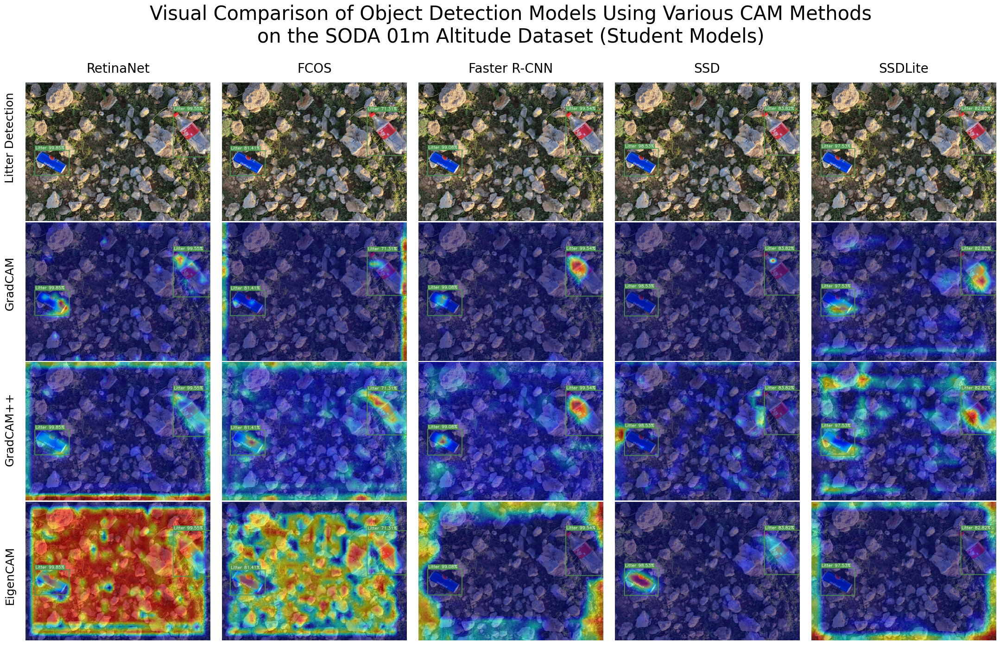

In [26]:
# Resize target
resize_to = (400, 300)

# Define models and layout
model_names = list(image_results.keys())
cols = len(model_names)
rows = 4  # Original, CAM, CAM+Boxes

# Create figure and axes
fig, axes = plt.subplots(rows, cols, figsize=(4.5 * cols, 3.5 * rows))

# Academic-style suptitle
fig.suptitle("Visual Comparison of Object Detection Models Using Various CAM Methods\non the SODA 01m Altitude Dataset (Student Models)", fontsize=30, y=1.05)

# Define row labels
row_titles = [
    "Litter Detection", #Results
    "GradCAM",
    "GradCAM++",
    "EigenCAM", 
    # "Overlayed Results"
]

# Loop over models and rows
for col_idx, model_name in enumerate(model_names):
    data = image_results[model_name]

    raw = np.array(Image.fromarray(data["image"]).resize(resize_to))
    cam = np.array(Image.fromarray(data["grad_cam"]).resize(resize_to))
    cam_plus_plus = np.array(Image.fromarray(data["grad_cam_plus_plus"]).resize(resize_to))
    eigen = np.array(Image.fromarray(data["image_with_bounding_boxes"]).resize(resize_to))

    images = [raw, cam, cam_plus_plus, eigen]

    for row_idx in range(rows):
        ax = axes[row_idx, col_idx]
        ax.imshow(images[row_idx])
        ax.axis("off")

        if row_idx == 0:
            ax.set_title(model_name, fontsize=20, pad=15)


row_spacing = (1 - 0.1) / rows  # 0.1 ensures some margin at the top

# Now manually add row titles (not tied to axes)
for row_idx, row_title in enumerate(row_titles):
    fig.text(
        0.02,                                           # x position (more left)
        1 - row_idx * row_spacing - 0.155,                          # y position, adjusted for reduced space
        row_title, 
        va='center', 
        ha='center', 
        fontsize=18,                                    # Keeping consistent font size for all rows
        rotation=90
    )

# Adjust layout
plt.subplots_adjust(left=0.03, right=0.97, top=0.93, bottom=0.07, wspace=0.01, hspace=0.01)
# Create a directory for saving the figure if it doesn't exist
if not os.path.exists('../Assets/figures'):
    os.makedirs('../Assets/figures')
# Save the figure
plt.savefig('../Assets/figures/gradcam_comparison_student.jpg', dpi=150, bbox_inches='tight')
plt.show()
